<a href="https://colab.research.google.com/github/mazon1/ML-Projects/blob/master/MUSDBtrain.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# !pip3 install stempeg
# import stempeg
# import os
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
import tensorflow as tf
# import librosa
# import numpy as np
# %cd drive/My\ Drive/

###This function preprocesses one song at a time

In [ ]:
def datapreprocessing():
  import os
  import stempeg
  # writer = tf.io.TFRecordWriter(file)
  L = os.listdir('/content/drive/My Drive/train') # list contains names of all the songs in training dataset
  for x in range(100):
    print(x)
    # y = x%100
    # track = mus[x%100]
    track, sr = stempeg.read_stems('/content/drive/My Drive/train/' + str(L[x]))    # stempeg is used to read mp4 files and convert them into np array
    if track.shape[0]>20000000:
      track = track[:18000000, :,:]
    mix, bass, drums, vocals, others = separate_instruments(track)
    # l_chmix, r_chmix = separate_channels(mix)
    # l_chbass, r_chbass = separate_channels(bass)
    # l_chdrums, r_chdrums = separate_channels(drums)
    # l_chvocals, r_chvocals = separate_channels(vocals)
    # l_chothers, r_chothers = separate_channels(others)
    l_mix_stft_db = stft_n_others(mix)
    l_drums_stft_db = stft_n_others(drums)
    l_bass_stft_db = stft_n_others(bass)
    l_vocals_stft_db = stft_n_others(vocals)
    l_others_stft_db = stft_n_others(others)
    # l_mix_stft, l_mix_mag, l_mix_stft_phase, l_mix_stft_db = stft_n_others(l_chmix)
    # l_drums_stft, l_drums_mag, l_drums_stft_phase, l_drums_stft_db = stft_n_others(l_chdrums)
    # l_vocals_stft, l_vocals_mag, l_vocals_stft_phase, l_vocals_stft_db = stft_n_others(l_chvocals)
    # l_others_stft, l_others_mag, l_others_stft_phase, l_others_stft_db = stft_n_others(l_chothers)
    # l_bass_stft, l_bass_mag, l_bass_stft_phase, l_bass_stft_db = stft_n_others(l_chbass)
    # print(l_bass_mag.shape)
    mix_l = get_data(l_mix_stft_db)
    others_l = get_data(l_others_stft_db)
    bass_l = get_data(l_bass_stft_db)
    vocals_l = get_data(l_vocals_stft_db)
    drums_l = get_data(l_drums_stft_db)
    print("mix shape is:",mix_l.shape)

    # for i in range(mix_l.shape[0]):
    #   # print("i is",i)
    #   X = mix_l[i, :,:].ravel()
    #   Y = [bass_l[i,:,:].ravel(),drums_l[i,:,:].ravel(),others_l[i,:,:].ravel(),vocals_l[i,:,:].ravel()]
    #   example = tf.train.Example(features = tf.train.Features(feature={
    #       "X" : tf.train.Feature(float_list = tf.train.FloatList(value=X)),
    #       "bass" : tf.train.Feature(float_list = tf.train.FloatList(value = Y[0])),
    #       "drums" : tf.train.Feature(float_list = tf.train.FloatList(value = Y[1])),
    #       "others" : tf.train.Feature(float_list = tf.train.FloatList(value = Y[2])),
    #       "vocals" : tf.train.Feature(float_list = tf.train.FloatList(value = Y[3]))
    #   }))
    #   writer.write(example.SerializeToString())

    # yield drums_l.shape
    yield mix_l.reshape(-1, 513,25, 1), [bass_l.reshape(-1, 513,25, 1), drums_l.reshape(-1, 513,25, 1), others_l.reshape(-1, 513,25, 1), vocals_l.reshape(-1, 513,25, 1)]

In [ ]:
def separate_instruments(track):
  mix = track[0,:,0].reshape((-1,))
  bass = track[2,:,0].reshape((-1,))
  drums = track[1,:,0].reshape((-1,))
  vocals = track[4,:,0].reshape((-1,))
  others = track[3,:,0].reshape((-1,))
  return mix, bass, drums, vocals, others


# def separate_channels(audio):
#   # audio = instrument.audio
#   l_channel = audio[:, 0].reshape(-1, )
#   r_channel = audio[:, 1].reshape(-1, )
#   return l_channel, r_channel


def stft_n_others(channel):
  stft = librosa.stft(channel, n_fft = 1024, hop_length = 256)
  mag_channel, phase_channel = librosa.magphase(stft)
  db = librosa.amplitude_to_db(mag_channel)
  return db
  # return stft, mag_channel, phase_channel, db


def get_data(matrix):
  fbins, tbins = matrix.shape
  data = np.zeros((int((tbins-1)/25) + 1, fbins, 25))
  for i in range(int(tbins/25)):
    data[i, :, :] = matrix[:, i*25: (i+1)*25]
  return data

###THE MODEL

In [ ]:
def func_model(input_shape=(513,25, 1), Con1 = None, MaxP=None, Con2 = None, dense=None, reshape=None, ConT2 = None, Ups = None, ConT1 = None):
# Con1 is like [64, (3,3)]
# Maxp is like (2,2)
# Con2 is a dict, {'bass' : [64, (3,3)], 'vocals' : [32, (2,2)], etc, etc}
# dense is a dict, {'bass' : [512,512,1234], etc}
# reshape is a dict, (values are tuples)
# ConT2 is a dict
# Ups is a dict
# ConT1 is a dict


# Extracting Parameters
  Con2_bass, Con2_vocals, Con2_drums, Con2_others = Con2['bass'], Con2['vocals'], Con2['drums'], Con2['others']
  dense_bass, dense_vocals, dense_drums, dense_others = dense['bass'], dense['vocals'], dense['drums'], dense['others']
  reshape_bass, reshape_vocals, reshape_drums, reshape_others = reshape['bass'], reshape['vocals'], reshape['drums'], reshape['others']
  ConT2_bass, ConT2_vocals, ConT2_drums, ConT2_others = ConT2['bass'], ConT2['vocals'], ConT2['drums'], ConT2['others']
  Ups_bass, Ups_vocals, Ups_drums, Ups_others = Ups['bass'], Ups['vocals'], Ups['drums'], Ups['others']
  ConT1_bass, ConT1_vocals, ConT1_drums, ConT1_others = ConT1['bass'], ConT1['vocals'], ConT1['drums'], ConT1['others']

  inp = Input(shape = input_shape)
  inp_ = Conv2D(Con1[0], Con1[1])(inp)
  # inp_ = MaxPool2D(MaxP)(inp_)

  inp_bass = Conv2D(Con2_bass[0], Con2_bass[1])(inp_)
  inp_vocals = Conv2D(Con2_vocals[0], Con2_vocals[1])(inp_)
  inp_drums = Conv2D(Con2_drums[0], Con2_drums[1])(inp_)
  inp_others = Conv2D(Con2_others[0], Con2_others[1])(inp_)

  inp_bass = Flatten()(inp_bass)
  inp_vocals = Flatten()(inp_vocals)
  inp_drums = Flatten()(inp_drums)
  inp_others = Flatten()(inp_others)

  for layer in dense_bass:
    inp_bass =Dense(layer, activation='relu')(inp_bass)
  for layer in dense_vocals:
    inp_vocals =Dense(layer, activation='relu')(inp_vocals)
  for layer in dense_drums:
    inp_drums =Dense(layer, activation='relu')(inp_drums)
  for layer in dense_others:
    inp_others =Dense(layer, activation='relu')(inp_others)

  inp_bass = Reshape(reshape_bass)(inp_bass)
  inp_drums = Reshape(reshape_drums)(inp_drums)
  inp_others = Reshape(reshape_others)(inp_others)
  inp_vocals = Reshape(reshape_vocals)(inp_vocals)

  inp_bass = Conv2DTranspose(ConT2_bass[0], ConT2_bass[1])(inp_bass)
  inp_vocals = Conv2DTranspose(ConT2_vocals[0], ConT2_vocals[1])(inp_vocals)
  inp_drums = Conv2DTranspose(ConT2_drums[0], ConT2_drums[1])(inp_drums)
  inp_others = Conv2DTranspose(ConT2_others[0], ConT2_others[1])(inp_others)

  # inp_bass = UpSampling2D(Ups_bass)(inp_bass)
  # inp_others = UpSampling2D(Ups_others)(inp_others)
  # inp_drums = UpSampling2D(Ups_drums)(inp_drums)
  # inp_vocals = UpSampling2D(Ups_vocals)(inp_vocals)

  inp_bass = Conv2DTranspose(ConT1_bass[0], ConT1_bass[1], name='bass')(inp_bass)
  inp_vocals = Conv2DTranspose(ConT1_vocals[0], ConT1_vocals[1], name = 'vocals')(inp_vocals)
  inp_drums = Conv2DTranspose(ConT1_drums[0], ConT1_drums[1], name = 'drums')(inp_drums)
  inp_others = Conv2DTranspose(ConT1_others[0], ConT1_others[1], name = 'others')(inp_others)


  model = Model(inp, [inp_bass, inp_drums, inp_others, inp_vocals])
  model.compile(loss = 'mean_squared_error', optimizer = 'adam')
  return model



In [ ]:
model = load_model('drive/My Drive/mymodel')

In [ ]:
i=0
for x, y in datapreprocessing():
  model.fit(x, y)
  if i%3 == 1:
    model.save("drive/My Drive/mymodel")
  i+=1

0
mix shape is: (1181, 513, 25)
37/37 [==============================] - 0s 12ms/step - loss: 169.4702 - bass_loss: 24.2439 - drums_loss: 38.4607 - others_loss: 29.7669 - vocals_loss: 76.9987
1
mix shape is: (1640, 513, 25)
52/52 [==============================] - 1s 12ms/step - loss: 390.9554 - bass_loss: 93.0284 - drums_loss: 87.8084 - others_loss: 72.0546 - vocals_loss: 138.0640
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: drive/My Drive/mymodel/assets
2
mix shape is: (1416, 513, 25)
45/45 [==============================] - 1s 13ms/step - loss: 295.8823 - bass_loss: 23.5755 - drums_loss: 63.3644 - others_loss: 119.9012 - vocals_loss: 89.0412
3
mix shape is: (1141, 513, 25)
36/36 [==============================] - 0s 13ms/step - loss: 367.0447 - bass_loss: 77.3094 - drums_loss: 68.1757 - others_loss: 122.3977 - vocals_loss: 99.1619
4
mix shape is: (1355, 513, 25)
43/43 [==============================] - 1s 13ms/st

In [ ]:
model.save('drive/My Drive/mymodel')

INFO:tensorflow:Assets written to: drive/My Drive/mymodel/assets


In [ ]:
# Fitting the model
#It runs for a maximum of 50 iterations then crashes
Con1 = [64, (513,1)]
MaxP = (2,2)
Con2 = {
'bass' : [64, (1,12)],
'vocals' : [64, (1,12)],
'others' : [64, (1,12)],
'drums' : [64, (1,12)]
}
dense = {
'bass' : [512, 512,512, 64*14],
'vocals' : [512, 512,512, 64*14],
'others' : [512, 512,512, 64*14],
'drums' : [512, 512,512, 64*14],
}
reshape = {
'bass' : (1,14,64),
'vocals' : (1,14,64),
'others' : (1,14,64),
'drums' : (1,14,64),
}
ConT2 = {
'bass' : [64, (1,12)],
'vocals' : [64, (1,12)],
'others' : [64, (1,12)],
'drums' : [64, (1,12)]
}

Ups = {
'bass' : (2,2),
'vocals' : (2,2),
'others' : (2,2),
'drums' : (2,2),
}

ConT1 = {
'bass' : [1, (513,1)],
'vocals' : [1, (513,1)],
'others' : [1, (513,1)],
'drums' : [1, (513,1)]
}

model_1 = func_model(Con1 = Con1, MaxP = MaxP, Con2 = Con2, dense = dense, reshape = reshape, ConT2 = ConT2, Ups = Ups, ConT1 = ConT1)
# i=0
# for x, y in datapreprocessing():
#   model_1.fit(x, y)
#   if i%3 == 2:
#     model_1.save("mymodel2")
#   i+=1

In [ ]:
datapreprocessing("traindata.tfrecords")

0
mix shape is: (1181, 513, 25)
1
mix shape is: (1640, 513, 25)
2
mix shape is: (1416, 513, 25)
3
mix shape is: (1141, 513, 25)
4
mix shape is: (1355, 513, 25)
5
mix shape is: (1126, 513, 25)
6
mix shape is: (1217, 513, 25)
7
mix shape is: (1303, 513, 25)
8
mix shape is: (2885, 513, 25)
9
mix shape is: (3544, 513, 25)
10
mix shape is: (1454, 513, 25)
11
mix shape is: (1848, 513, 25)
12
mix shape is: (1432, 513, 25)
13
mix shape is: (1786, 513, 25)
14
mix shape is: (1012, 513, 25)
15
mix shape is: (1590, 513, 25)
16
mix shape is: (2747, 513, 25)
17
mix shape is: (1919, 513, 25)
18
mix shape is: (2079, 513, 25)
19
mix shape is: (1194, 513, 25)
20
mix shape is: (1348, 513, 25)
21
mix shape is: (1208, 513, 25)
22
mix shape is: (2030, 513, 25)
23
mix shape is: (2082, 513, 25)
24
mix shape is: (1604, 513, 25)
25
mix shape is: (2032, 513, 25)
26
mix shape is: (2460, 513, 25)
27
mix shape is: (1774, 513, 25)
28
mix shape is: (1162, 513, 25)
29
mix shape is: (1366, 513, 25)
30
mix shape is: (13

In [ ]:
import tensorflow as tf

def _parse_function(proto):
  keys_to_features = {
      "X" : tf.io.FixedLenFeature([25*513], tf.float32),
      "bass" : tf.io.FixedLenFeature([25*513], tf.float32),
      "drums" : tf.io.FixedLenFeature([25*513], tf.float32),
      "others" : tf.io.FixedLenFeature([25*513], tf.float32),
      "vocals" : tf.io.FixedLenFeature([25*513], tf.float32)
  }
  parsed_features = tf.io.parse_single_example(proto, keys_to_features)
  # parsed_features['X'] = tf.io.decode_raw(parsed_features['X'], tf.float32)
  # parsed_features['bass'] = tf.io.decode_raw(parsed_features['bass'], tf.float32)
  # parsed_features['drums'] = tf.io.decode_raw(parsed_features['drums'], tf.float32)
  # parsed_features['others'] = tf.io.decode_raw(parsed_features['others'], tf.float32)
  # parsed_features['vocals'] = tf.io.decode_raw(parsed_features['vocals'], tf.float32)
  return parsed_features['X'], parsed_features['bass'], parsed_features['drums'], parsed_features['others'], parsed_features['vocals']


def create_dataset(filepath):
  dataset = tf.data.TFRecordDataset(filepath)
  
  # dataset = dataset.repeat()
  # dataset = dataset.shuffle(128)
  dataset = dataset.repeat()
  dataset = dataset.map(_parse_function, num_parallel_calls=32)
  # dataset = dataset.batch(batch_size).prefetch(1)
  # dataset = dataset.batch(100)
  iterator = tf.compat.v1.data.make_one_shot_iterator(dataset)
  # print("haha")
  # X, bass, drums, others, vocals = iterator.get_next()
  # X = tf.reshape(X, [-1, 513,25,1])
  # bass = tf.reshape(bass, [-1, 513,25,1])
  # drums = tf.reshape(drums, [-1, 513, 25, 1])
  # others = tf.reshape(others, [-1, 513, 25, 1])
  # vocals = tf.reshape(vocals, [-1, 513, 25, 1])
  return iterator
  # return X, bass, drums, others, vocals



from tensorflow.keras.layers import *
from tensorflow.keras.models import *
it = create_dataset("drive/My Drive/traindata.tfrecords")
# ite = create_dataset("drive/My Drive/traindata.tfrecords")
# i=0
# for i in range(10000):
#   X,bass,drums,others,vocals=ite.get_next()
#   print(X.shape)
#   print("i", i)
#   i+=1
def func_model(Con1 = None, MaxP=None, Con2 = None, dense=None, reshape=None, ConT2 = None, Ups = None, ConT1 = None):
# Con1 is like [64, (3,3)]
# Maxp is like (2,2)
# Con2 is a dict, {'bass' : [64, (3,3)], 'vocals' : [32, (2,2)], etc, etc}
# dense is a dict, {'bass' : [512,512,1234], etc}
# reshape is a dict, (values are tuples)
# ConT2 is a dict
# Ups is a dict
# ConT1 is a dict


# Extracting Parameters
  Con2_bass, Con2_vocals, Con2_drums, Con2_others = Con2['bass'], Con2['vocals'], Con2['drums'], Con2['others']
  dense_bass, dense_vocals, dense_drums, dense_others = dense['bass'], dense['vocals'], dense['drums'], dense['others']
  reshape_bass, reshape_vocals, reshape_drums, reshape_others = reshape['bass'], reshape['vocals'], reshape['drums'], reshape['others']
  ConT2_bass, ConT2_vocals, ConT2_drums, ConT2_others = ConT2['bass'], ConT2['vocals'], ConT2['drums'], ConT2['others']
  Ups_bass, Ups_vocals, Ups_drums, Ups_others = Ups['bass'], Ups['vocals'], Ups['drums'], Ups['others']
  ConT1_bass, ConT1_vocals, ConT1_drums, ConT1_others = ConT1['bass'], ConT1['vocals'], ConT1['drums'], ConT1['others']

  inp = Input(shape=(513,25,1))
  inp_ = Conv2D(Con1[0], Con1[1])(inp)
  # inp_ = MaxPool2D(MaxP)(inp_)

  inp_bass = Conv2D(Con2_bass[0], Con2_bass[1])(inp_)
  inp_vocals = Conv2D(Con2_vocals[0], Con2_vocals[1])(inp_)
  inp_drums = Conv2D(Con2_drums[0], Con2_drums[1])(inp_)
  inp_others = Conv2D(Con2_others[0], Con2_others[1])(inp_)

  inp_bass = Flatten()(inp_bass)
  inp_vocals = Flatten()(inp_vocals)
  inp_drums = Flatten()(inp_drums)
  inp_others = Flatten()(inp_others)

  for layer in dense_bass:
    inp_bass =Dense(layer, activation='relu')(inp_bass)
  for layer in dense_vocals:
    inp_vocals =Dense(layer, activation='relu')(inp_vocals)
  for layer in dense_drums:
    inp_drums =Dense(layer, activation='relu')(inp_drums)
  for layer in dense_others:
    inp_others =Dense(layer, activation='relu')(inp_others)

  inp_bass = Reshape(reshape_bass)(inp_bass)
  inp_drums = Reshape(reshape_drums)(inp_drums)
  inp_others = Reshape(reshape_others)(inp_others)
  inp_vocals = Reshape(reshape_vocals)(inp_vocals)

  inp_bass = Conv2DTranspose(ConT2_bass[0], ConT2_bass[1])(inp_bass)
  inp_vocals = Conv2DTranspose(ConT2_vocals[0], ConT2_vocals[1])(inp_vocals)
  inp_drums = Conv2DTranspose(ConT2_drums[0], ConT2_drums[1])(inp_drums)
  inp_others = Conv2DTranspose(ConT2_others[0], ConT2_others[1])(inp_others)

  # inp_bass = UpSampling2D(Ups_bass)(inp_bass)
  # inp_others = UpSampling2D(Ups_others)(inp_others)
  # inp_drums = UpSampling2D(Ups_drums)(inp_drums)
  # inp_vocals = UpSampling2D(Ups_vocals)(inp_vocals)

  inp_bass = Conv2DTranspose(ConT1_bass[0], ConT1_bass[1], name='bass')(inp_bass)
  inp_vocals = Conv2DTranspose(ConT1_vocals[0], ConT1_vocals[1], name = 'vocals')(inp_vocals)
  inp_drums = Conv2DTranspose(ConT1_drums[0], ConT1_drums[1], name = 'drums')(inp_drums)
  inp_others = Conv2DTranspose(ConT1_others[0], ConT1_others[1], name = 'others')(inp_others)


  model = Model(inp, [inp_bass, inp_drums, inp_others, inp_vocals])
  model.compile(loss = 'mean_squared_error', optimizer = 'adam')
  return model

Con1 = [64, (513,1)]
MaxP = (2,2)
Con2 = {
'bass' : [64, (1,12)],
'vocals' : [64, (1,12)],
'others' : [64, (1,12)],
'drums' : [64, (1,12)]
}
dense = {
'bass' : [512, 512,512, 64*14],
'vocals' : [512, 512,512, 64*14],
'others' : [512, 512,512, 64*14],
'drums' : [512, 512,512, 64*14],
}
reshape = {
'bass' : (1,14,64),
'vocals' : (1,14,64),
'others' : (1,14,64),
'drums' : (1,14,64),
}
ConT2 = {
'bass' : [64, (1,12)],
'vocals' : [64, (1,12)],
'others' : [64, (1,12)],
'drums' : [64, (1,12)]
}

Ups = {
'bass' : (2,2),
'vocals' : (2,2),
'others' : (2,2),
'drums' : (2,2),
}

ConT1 = {
'bass' : [1, (513,1)],
'vocals' : [1, (513,1)],
'others' : [1, (513,1)],
'drums' : [1, (513,1)]
}

model = func_model(Con1 = Con1, MaxP = MaxP, Con2 = Con2, dense = dense, reshape = reshape, ConT2 = ConT2, Ups = Ups, ConT1 = ConT1)
for i in range(10000000):
  X, bass, drums, vocals, others = it.get_next()
  X = tf.reshape(X,[-1, 513, 25, 1])
  bass = tf.reshape(bass, [-1, 513, 25, 1])
  drums = tf.reshape(drums,[-1, 513, 25, 1])
  others = tf.reshape(others, [-1, 513, 25, 1])
  vocals = tf.reshape(vocals, [-1, 513, 25, 1])
  model.fit(X,[bass,drums,others,vocals])


1/1 [==============================] - 0s 877us/step - loss: 452.1406 - bass_loss: 234.9267 - drums_loss: 86.1376 - others_loss: 65.8557 - vocals_loss: 65.2206


KeyboardInterrupt: ignored

In [ ]:
!ls

drive  sample_data


In [ ]:
c = 0 
for record in tf.compat.v1.io.tf_record_iterator("drive/My Drive/traindata.tfrecords"):
  c+=1
print(c)

DataLossError: ignored

# Pipelines

In [ ]:
def parse(serialize):
  features={
      "X" : tf.io.FixedLenFeature([513*25], tf.float32),
      "bass" : tf.io.FixedLenFeature([513*25], tf.float32),
      "drums" : tf.io.FixedLenFeature([513*25], tf.float32),
      "vocals" : tf.io.FixedLenFeature([513*25], tf.float32),
      "others" : tf.io.FixedLenFeature([513*25], tf.float32)
  }
  
  parsed_example = tf.io.parse_single_example(serialized = serialize, features=features)
  X = tf.reshape(parsed_example['X'], [513,25,1])
  bass = tf.reshape(parsed_example['bass'], [513,25,1])
  drums = tf.reshape(parsed_example['drums'], [513,25,1])
  others = tf.reshape(parsed_example['others'], [513,25,1])
  vocals = tf.reshape(parsed_example['vocals'], [513,25,1])
  return X, vocals

def input_fn(file, batch_size=32, buffer_size=2048):
  dataset = tf.data.TFRecordDataset(filenames=file)
  dataset = dataset.map(parse)
  # dataset = dataset.shuffle(buffer_size=buffer_size)
  # dataset = dataset.repeat()
  # dataset = dataset.batch(128)
  return dataset
#   # itera = tf.compat.v1.make_one_shot_iterator(dataset)
#   # X, bass, drums, others, vocals = itera.get_next()
#   # x = {
#   #     'X' : X,
#   # }
#   # y = [bass, drums, others, vocals]
#   # return x,y


def train_inp_fn():
  return input_fn('drive/My Drive/tr10.tfrecords')

# feature_audio = tf.feature_column.numeric_column("X", shape=(-1, 513,25,1))

  

In [ ]:
dst = train_inp_fn()

In [ ]:
for epoch in range(3):
  for batch in dst:
    print(batch[0].shape)
  print("epoch enddd")

(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 1)
(32, 513, 25, 

DataLossError: ignored

In [ ]:
def func_model(input_shape=(513,25, 1), Con1 = None, MaxP=None, Con2 = None, dense=None, reshape=None, ConT2 = None, Ups = None, ConT1 = None):
# Con1 is like [64, (3,3)]
# Maxp is like (2,2)
# Con2 is a dict, {'bass' : [64, (3,3)], 'vocals' : [32, (2,2)], etc, etc}
# dense is a dict, {'bass' : [512,512,1234], etc}
# reshape is a dict, (values are tuples)
# ConT2 is a dict
# Ups is a dict
# ConT1 is a dict


# Extracting Parameters
  Con2_bass, Con2_vocals, Con2_drums, Con2_others = Con2['bass'], Con2['vocals'], Con2['drums'], Con2['others']
  dense_bass, dense_vocals, dense_drums, dense_others = dense['bass'], dense['vocals'], dense['drums'], dense['others']
  reshape_bass, reshape_vocals, reshape_drums, reshape_others = reshape['bass'], reshape['vocals'], reshape['drums'], reshape['others']
  ConT2_bass, ConT2_vocals, ConT2_drums, ConT2_others = ConT2['bass'], ConT2['vocals'], ConT2['drums'], ConT2['others']
  Ups_bass, Ups_vocals, Ups_drums, Ups_others = Ups['bass'], Ups['vocals'], Ups['drums'], Ups['others']
  ConT1_bass, ConT1_vocals, ConT1_drums, ConT1_others = ConT1['bass'], ConT1['vocals'], ConT1['drums'], ConT1['others']

  inp = Input(shape = input_shape)
  inp_ = Conv2D(Con1[0], Con1[1])(inp)
  # inp_ = MaxPool2D(MaxP)(inp_)

  # inp_bass = Conv2D(Con2_bass[0], Con2_bass[1])(inp_)
  inp_vocals = Conv2D(Con2_vocals[0], Con2_vocals[1])(inp_)
  # inp_drums = Conv2D(Con2_drums[0], Con2_drums[1])(inp_)
  # inp_others = Conv2D(Con2_others[0], Con2_others[1])(inp_)

  # inp_bass = Flatten()(inp_bass)
  inp_vocals = Flatten()(inp_vocals)
  # inp_drums = Flatten()(inp_drums)
  # inp_others = Flatten()(inp_others)

  # for layer in dense_bass:
  #   inp_bass =Dense(layer, activation='relu')(inp_bass)
  for layer in dense_vocals:
    inp_vocals =Dense(layer, activation='relu')(inp_vocals)
  # for layer in dense_drums:
  #   inp_drums =Dense(layer, activation='relu')(inp_drums)
  # for layer in dense_others:
  #   inp_others =Dense(layer, activation='relu')(inp_others)

  # inp_bass = Reshape(reshape_bass)(inp_bass)
  # inp_drums = Reshape(reshape_drums)(inp_drums)
  # inp_others = Reshape(reshape_others)(inp_others)
  inp_vocals = Reshape(reshape_vocals)(inp_vocals)

  # inp_bass = Conv2DTranspose(ConT2_bass[0], ConT2_bass[1])(inp_bass)
  inp_vocals = Conv2DTranspose(ConT2_vocals[0], ConT2_vocals[1])(inp_vocals)
  # inp_drums = Conv2DTranspose(ConT2_drums[0], ConT2_drums[1])(inp_drums)
  # inp_others = Conv2DTranspose(ConT2_others[0], ConT2_others[1])(inp_others)

  # inp_bass = UpSampling2D(Ups_bass)(inp_bass)
  # inp_others = UpSampling2D(Ups_others)(inp_others)
  # inp_drums = UpSampling2D(Ups_drums)(inp_drums)
  # inp_vocals = UpSampling2D(Ups_vocals)(inp_vocals)

  # inp_bass = Conv2DTranspose(ConT1_bass[0], ConT1_bass[1], name='bass')(inp_bass)
  inp_vocals = Conv2DTranspose(ConT1_vocals[0], ConT1_vocals[1], name = 'vocals')(inp_vocals)
  # inp_drums = Conv2DTranspose(ConT1_drums[0], ConT1_drums[1], name = 'drums')(inp_drums)
  # inp_others = Conv2DTranspose(ConT1_others[0], ConT1_others[1], name = 'others')(inp_others)


  model = Model(inp, inp_vocals)
  model.compile(loss = 'mean_squared_error', optimizer = 'adam')
  return model

Con1 = [64, (513,1)]
MaxP = (2,2)
Con2 = {
'bass' : [64, (1,12)],
'vocals' : [64, (1,12)],
'others' : [64, (1,12)],
'drums' : [64, (1,12)]
}
dense = {
'bass' : [512, 512,512, 64*14],
'vocals' : [512, 512,512, 64*14],
'others' : [512, 512,512, 64*14],
'drums' : [512, 512,512, 64*14],
}
reshape = {
'bass' : (1,14,64),
'vocals' : (1,14,64),
'others' : (1,14,64),
'drums' : (1,14,64),
}
ConT2 = {
'bass' : [64, (1,12)],
'vocals' : [64, (1,12)],
'others' : [64, (1,12)],
'drums' : [64, (1,12)]
}

Ups = {
'bass' : (2,2),
'vocals' : (2,2),
'others' : (2,2),
'drums' : (2,2),
}

ConT1 = {
'bass' : [1, (513,1)],
'vocals' : [1, (513,1)],
'others' : [1, (513,1)],
'drums' : [1, (513,1)]
}

model = func_model(Con1 = Con1, MaxP = MaxP, Con2 = Con2, dense = dense, reshape = reshape, ConT2 = ConT2, Ups = Ups, ConT1 = ConT1)

model.fit(dst, epochs=10)



Epoch 1/10
    103/Unknown - 9s 89ms/step - loss: 395.7318

DataLossError: ignored

In [ ]:
for batch in dst:
  print(len(batch[1]))

128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128
128


DataLossError: ignored

In [ ]:
i=0

try:
  for _ in dst:
    i+=1
except Exception as e:
  print("error at ", i)
  print(e) 

In [ ]:
batch=_

In [ ]:
_.shape

AttributeError: ignored

In [ ]:
_[0].shape

TensorShape([128, 513, 25, 1])

In [ ]:
_[1]

513

In [ ]:
it = tf.compat.v1.data.make_one_shot_iterator(dst)
i=0
try:
  while i<4000000000:
    X, b = it.get_next()
    i+=1
except Exception as e:
  print("error at ",i)
  print(e)


error at  103
truncated record at 3403710216


In [ ]:
_

513

In [ ]:
X, b = it.get_next()

OutOfRangeError: ignored

In [ ]:
import struct
from crcmod.predefined import mkPredefinedCrcFun

_crc_fn = mkPredefinedCrcFun('crc-32c')


def calc_masked_crc(data):
    crc = _crc_fn(data)
    return (((crc >> 15) | (crc << 17)) + 0xa282ead8) & 0xFFFFFFFF


def validate_dataset_slower(filenames):
    total_records = 0
    total_bad_len_crc = 0
    total_bad_data_crc = 0
    for f_name in filenames:
        i = 0
        print('validating ', f_name)

        with open(f_name, 'rb') as f:

            len_bytes = f.read(8)
            while len(len_bytes) > 0:
                # tfrecord format is a wrapper around protobuf data
                length, = struct.unpack('<Q', len_bytes) # u64: length of the protobuf data (excluding the header)
                len_crc, = struct.unpack('<I', f.read(4)) # u32: masked crc32c of the length bytes
                data = f.read(length) # protobuf data
                data_crc, = struct.unpack('<I', f.read(4)) # u32: masked crc32c of the protobuf data

                if len_crc != calc_masked_crc(len_bytes):
                    print('bad crc on len at record', i)
                    total_bad_len_crc += 1

                if data_crc != calc_masked_crc(data):
                    print('bad crc on data at record', i)
                    total_bad_data_crc += 1

                i += 1
                len_bytes = f.read(8)

        print('checked', i, 'records')
        total_records += i
    print('checked', total_records, 'total records')
    print('total with bad length crc: ', total_bad_len_crc)
    print('total with bad data crc: ', total_bad_data_crc)

In [ ]:
validate_dataset_slower(["drive/My Drive/traindata.tfrecords"])

validating  drive/My Drive/traindata.tfrecords


error: ignored

In [ ]:
len(_)

2

In [ ]:
_[1]

TypeError: ignored

In [ ]:
_

2

In [ ]:
print(len(batch))

2


In [ ]:
print(batch[1])

tf.Tensor(
[[[-45.340897]
  [-45.340897]
  [-45.340897]
  ...
  [-45.340897]
  [-45.340897]
  [-45.340897]]

 [[-45.340897]
  [-45.340897]
  [-45.340897]
  ...
  [-45.340897]
  [-45.340897]
  [-45.340897]]

 [[-45.340897]
  [-45.340897]
  [-45.340897]
  ...
  [-45.340897]
  [-45.340897]
  [-45.340897]]

 ...

 [[-45.340897]
  [-45.340897]
  [-45.340897]
  ...
  [-45.340897]
  [-45.340897]
  [-45.340897]]

 [[-45.340897]
  [-45.340897]
  [-45.340897]
  ...
  [-45.340897]
  [-45.340897]
  [-45.340897]]

 [[-45.340897]
  [-45.340897]
  [-45.340897]
  ...
  [-45.340897]
  [-45.340897]
  [-45.340897]]], shape=(513, 25, 1), dtype=float32)


In [ ]:
print(batch[1].shape)

(513, 25, 1)


In [ ]:
print(batch[0].shape)

(513, 25, 1)


###HERE WE Make Predictions

In [ ]:
model.summary()

In [ ]:
song, sr = stempeg.read_stems("/content/drive/My Drive/train/A Classic Education - NightOwl.stem.mp4")
mix, _, _, _, _ = separate_instruments(song)
# mix_stft = librosa.stft(mix, n_fft=1024, hop_length=256)
# mix_mag, mix_phase = librosa.magphase(mix_stft)
# mix_db = stft_n_others(mix)
# s1 = mix_db.shape
# data = get_data(mix_db)
# bass, drums, others, vocals = model.predict(data)
# vocals_ = pred_to_stft(vocals, s1)
# print(vocals_.shape)
# others_ = pred_to_stft(others, s1)
# vocals_ = (vocals_*mix_phase/(vocals_ + others_))
# ist=get_istft(vocals_)
librosa.output.write_wav('drive/My Drive/vocals_1_.wav', mix, sr)




In [ ]:
mix_phase.shape

(513, 29501)

In [ ]:
def pred_to_stft(inst, shape_):
  Y = np.zeros((inst.shape[1], 25*inst.shape[0]))
  for i in range(inst.shape[0]):
    Y[:, i*25:(i+1)*25] = inst[i, :,:,0].reshape(inst.shape[1], 25)
  Y=Y[:, :shape_[1]]
  Y = librosa.db_to_amplitude(Y)
  return Y

In [ ]:
def get_istft(stft_, ):
  result = librosa.istft(stft_, hop_length=256)
  return result

In [ ]:
import pygame

In [ ]:
!pip3 install pygame
import pygame

     |████████████████████████████████| 11.4MB 6.1MB/s 
pygame 1.9.6
Hello from the pygame community. https://www.pygame.org/contribute.html


In [ ]:
pygame.init()

pygame.mixer.music.load("drive/My Drive/vocals_1_.wav")
pygame.mixer.music.play()
pygame.event.wait()

error: ignored

In [ ]:
from IPython.display import Audio

In [ ]:
Audio(mix, rate=sr)

In [ ]:
Audio(ist, rate=sr)

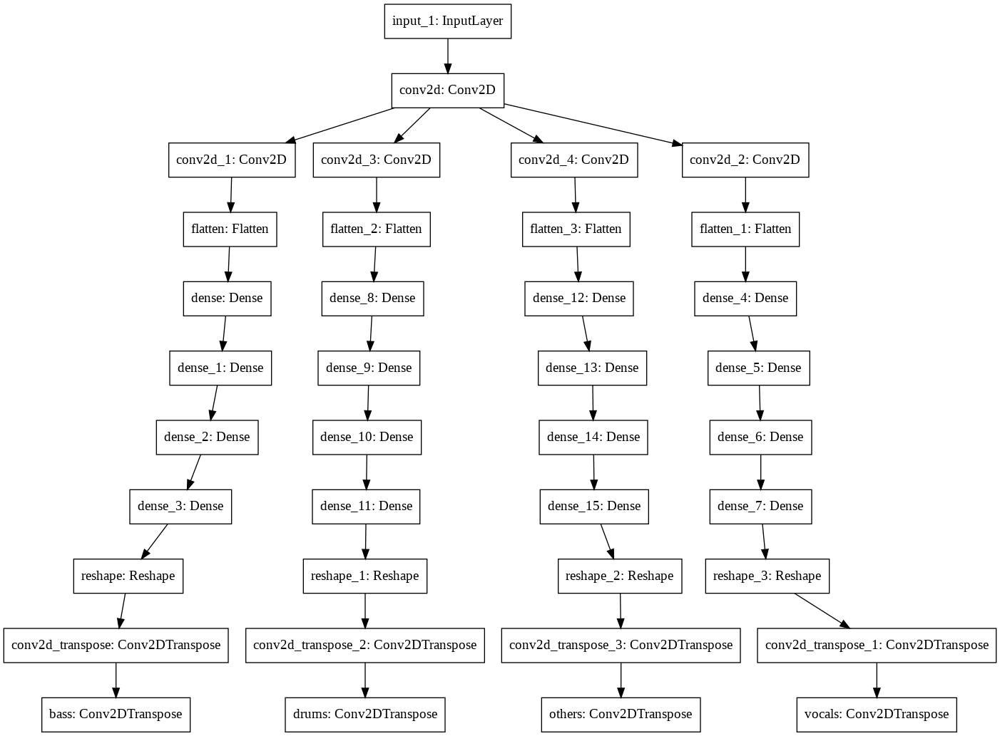

In [ ]:
tf.keras.utils.plot_model(model_1)